# Refraction Traveltime Tomography

### Author: M.Ravasi

This notebook creates the machinery to define a geometry, shoot rays, and extract those rays corresponding to available pairs of sources and receivers.

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import time
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt

from scipy.signal import filtfilt
from scipy.sparse.linalg import lsqr
from pylops.basicoperators import *
from pylops.optimization.leastsquares import *

from refrtomo.gaussnewton import gauss_newton
from refrtomo.invert import *
from refrtomo.least_squares import least_squares
from refrtomo.raytrace import raytrace
from refrtomo.survey import *
from refrtomo.tomomatrix import *

## Velocity model

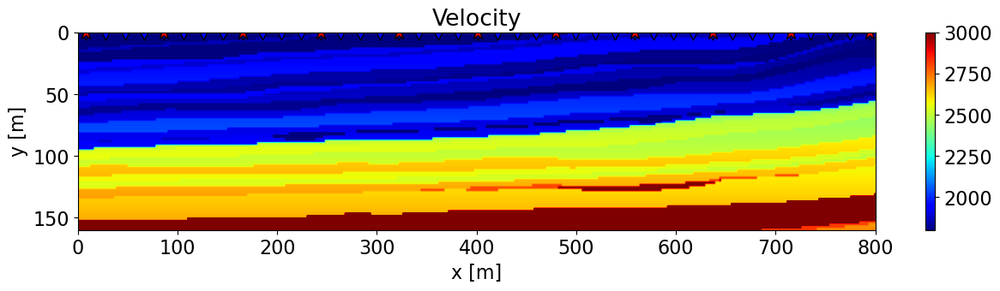

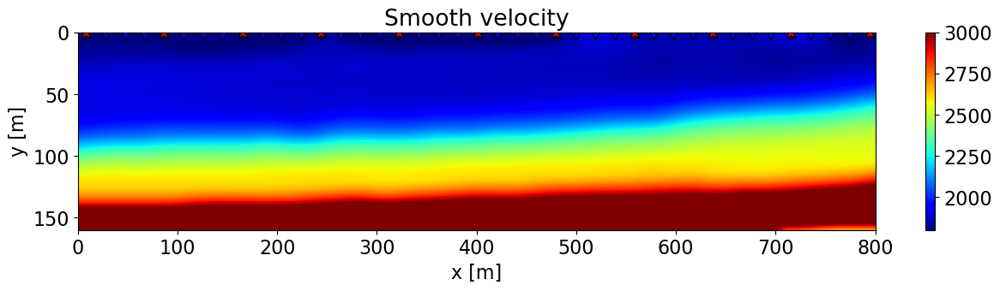

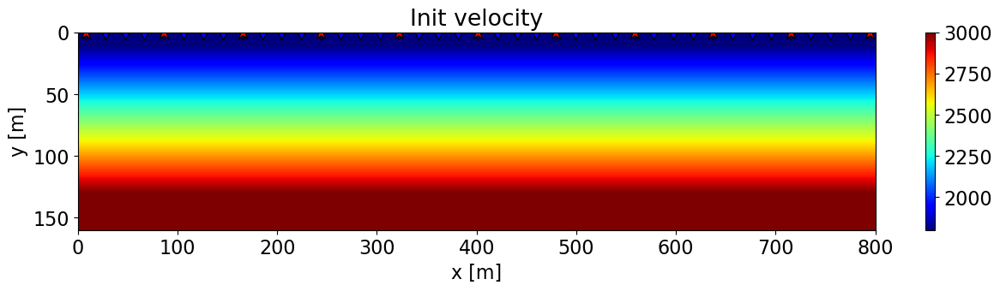

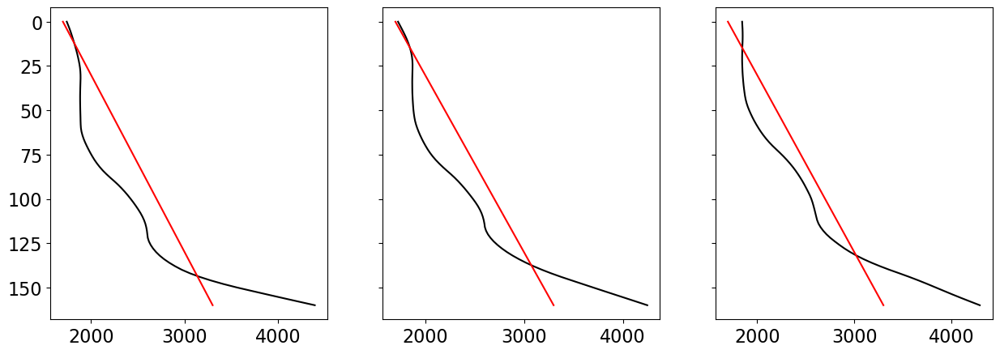

In [2]:
# Velocity model
nx, nz = 1360, 280
dx, dz = 2., 2.

vel_true = np.fromfile("../data/marmousi.bin", dtype='float32', sep="") 
vel_true = vel_true.reshape(nx, nz)[100:501, 100:181]#[500:901, 100:181]
nx, nz = vel_true.shape
x, z = np.arange(nx) * dx, np.arange(nz) * dz

# Smooth velocity
nsmooth = 15
vel_sm = filtfilt(np.ones(nsmooth)/float(nsmooth), 1, vel_true, axis=0)
vel_sm = filtfilt(np.ones(nsmooth)/float(nsmooth), 1, vel_sm, axis=1)

# Initial velocity
nsmooth = 15
vel_init = vel_sm.copy()
for _ in range(8):
    vel_init = filtfilt(np.ones(nsmooth)/float(nsmooth), 1, vel_init, axis=1)

vel_init = np.tile(1700 + 10 * z, (nx, 1))

# Receivers
nr = 41
rx = np.linspace(dx*4, (nx-4)*dx, nr)
rz = 0*np.ones(nr)
recs = np.vstack((rx, rz))
dr = recs[0,1]-recs[0,0]

# Sources
ns = 11
sx = np.linspace(dx*4, (nx-4)*dx, ns)
sz = 0*np.ones(ns)
sources = np.vstack((sx, sz))
ds = sources[0,1]-sources[0,0]

plt.figure(figsize=(15, 3))
im = plt.imshow(vel_true.T, cmap='jet', vmin=1800, vmax=3000, extent=(x[0], x[-1], z[-1], z[0]))
plt.scatter(recs[0],  recs[1], marker='v', s=150, c='b', edgecolors='k')
plt.scatter(sources[0], sources[1], marker='*', s=150, c='r', edgecolors='k')
plt.colorbar(im)
plt.axis('tight')
plt.xlabel('x [m]'),plt.ylabel('y [m]')
plt.title('Velocity')
plt.ylim(z[-1], z[0])

plt.figure(figsize=(15, 3))
im = plt.imshow(vel_sm.T, cmap='jet', vmin=1800, vmax=3000, extent=(x[0], x[-1], z[-1], z[0]))
plt.scatter(recs[0], recs[1], marker='v', s=150, c='b', edgecolors='k')
plt.scatter(sources[0], sources[1], marker='*', s=150, c='r', edgecolors='k')
plt.colorbar(im)
plt.axis('tight')
plt.xlabel('x [m]'),plt.ylabel('y [m]')
plt.title('Smooth velocity')
plt.ylim(z[-1], z[0])

plt.figure(figsize=(15, 3))
im = plt.imshow(vel_init.T, cmap='jet', vmin=1800, vmax=3000, extent=(x[0], x[-1], z[-1], z[0]))
plt.scatter(recs[0], recs[1], marker='v', s=150, c='b', edgecolors='k')
plt.scatter(sources[0], sources[1], marker='*', s=150, c='r', edgecolors='k')
plt.colorbar(im)
plt.axis('tight')
plt.xlabel('x [m]'),plt.ylabel('y [m]')
plt.title('Init velocity')
plt.ylim(z[-1], z[0]);

fig, axs = plt.subplots(1, 3, sharey=True, figsize=(15, 5))
for ax, ix in zip(axs, [nx//4, nx//2, 3*nx//4]):
    ax.plot(vel_sm[ix], z, 'k')
    ax.plot(vel_init[ix], z, 'r')
axs[-1].invert_yaxis()

## Survey geometry

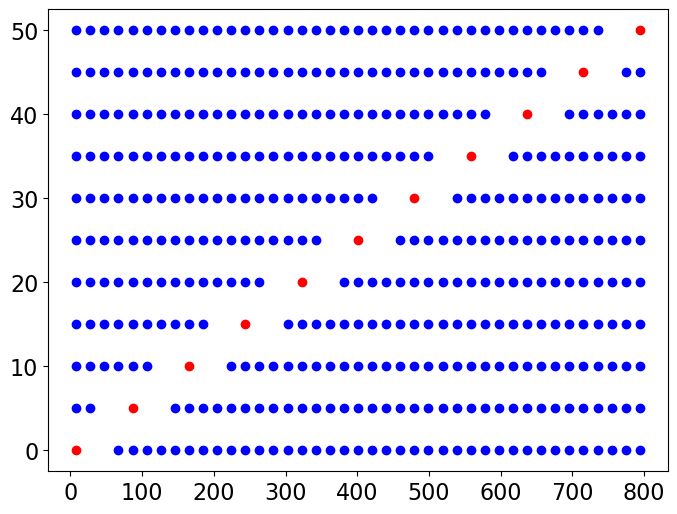

In [3]:
srcs = np.vstack((sx, sz))
recs = np.vstack((rx, rz))

survey = survey_geom(srcs, recs, minoffset=50)
display_survey(survey)

## Raytrace all sources

survey_raytrace: 400 Source-receiver pairs in survey, 305 Source-receiver paired with ray...


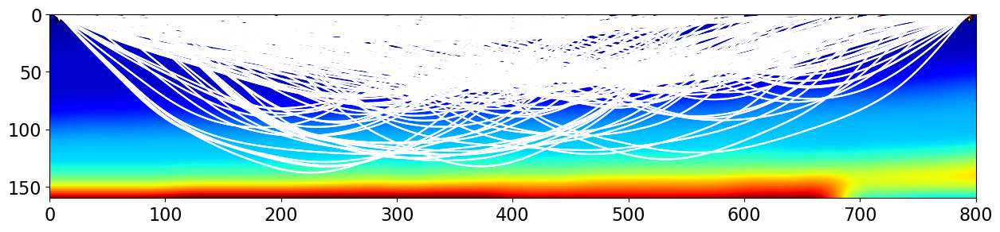

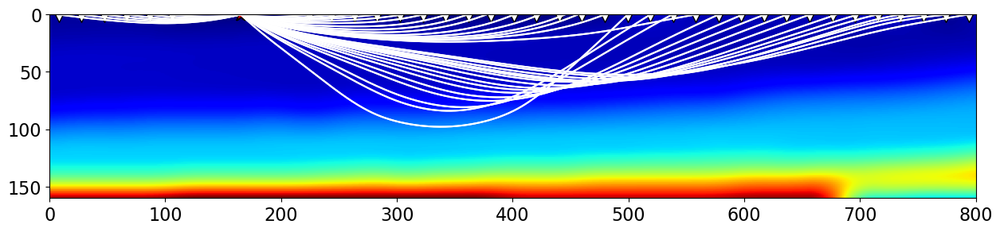

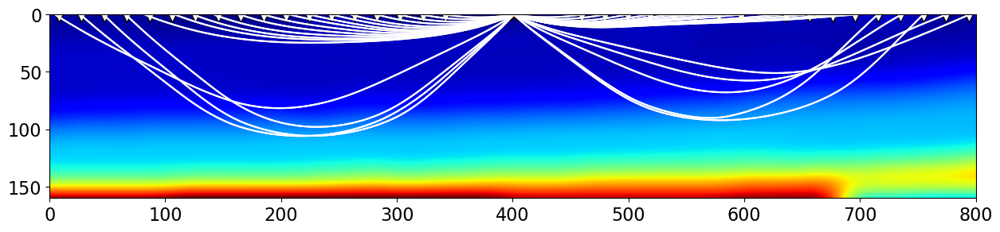

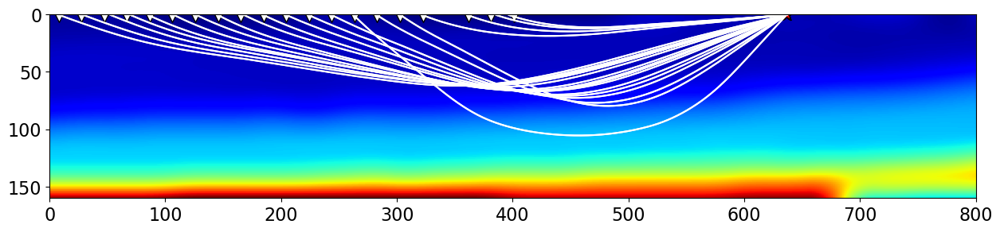

In [4]:
# Trace all rays
lmax = 1e3
nl = 2000
thetas = np.hstack([np.arange(-85, -40, 0.05), np.arange(40, 85, 0.05)])

avasurvey = survey_raytrace(survey, vel_sm.T, x, z, lmax, nl, thetas, dzout=5., ray_rec_mindistance=5., debug=True)

# Display rays
display_survey_rays(avasurvey, vel_sm.T, x, z, figsize=(15, 3))
display_survey_rays(avasurvey, vel_sm.T, x, z, sx=sx[ns//4], figsize=(15, 3))
display_survey_rays(avasurvey, vel_sm.T, x, z, sx=sx[ns//2], figsize=(15, 3))
display_survey_rays(avasurvey, vel_sm.T, x, z, sx=sx[3*ns//4], figsize=(15, 3))

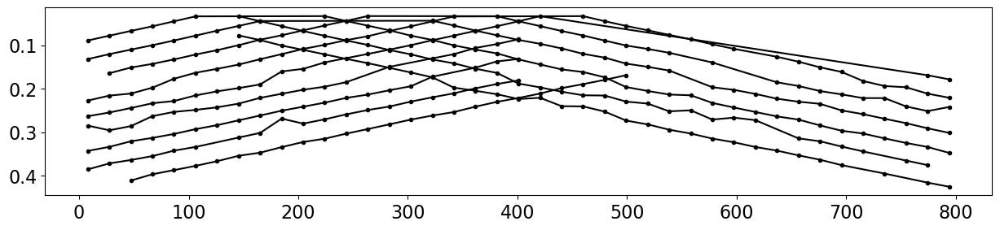

In [5]:
# Display observed traveltimes
fig, ax = plt.subplots(1, 1, figsize=(15, 3))
for isrc in range(ns):
    display_survey_tobs(avasurvey, sx[isrc], ax=ax)

## Create tomographic matrix

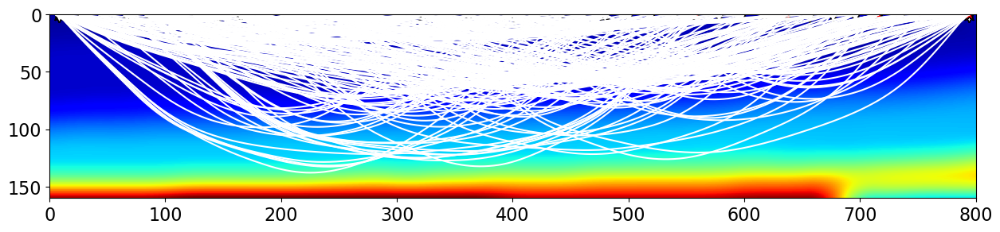

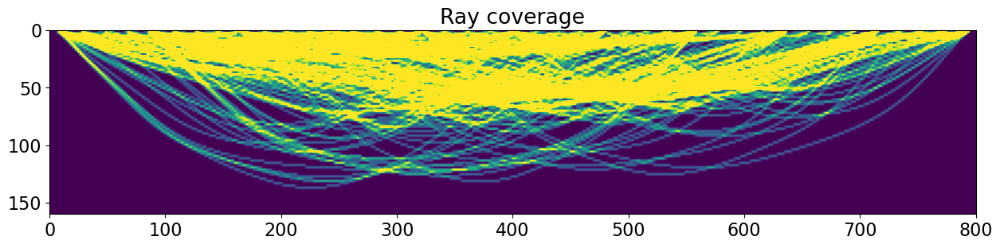

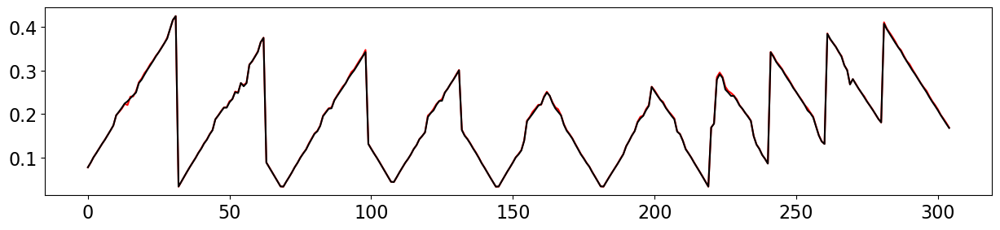

In [6]:
Robs = tomographic_matrix(avasurvey, dx, dz, 0, 0, nx, nz, x, z, plotflag=True, vel=vel_sm)

tobs = extract_tobs(avasurvey)
tobs_R = Robs @ (1/vel_sm.ravel())

plt.figure(figsize=(15, 3))
plt.plot(tobs, 'r')
plt.plot(tobs_R, 'k');

## Initial rays and traveltimes

survey_raytrace: 400 Source-receiver pairs in survey, 276 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 276 Rays in survey2, 189 Matched rays...


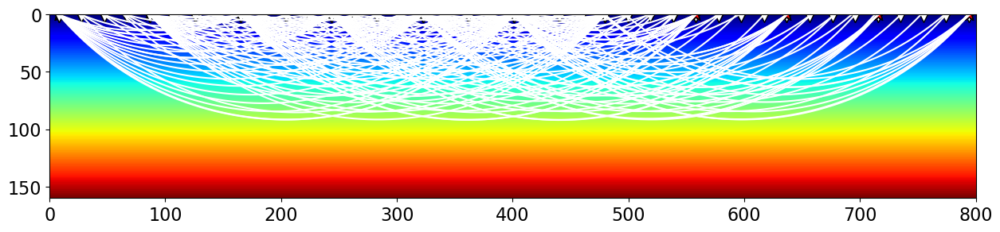

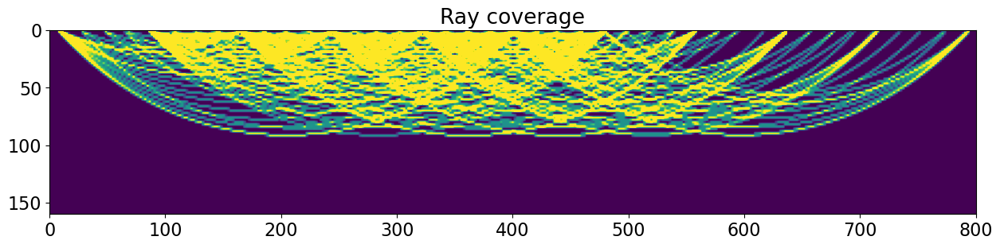

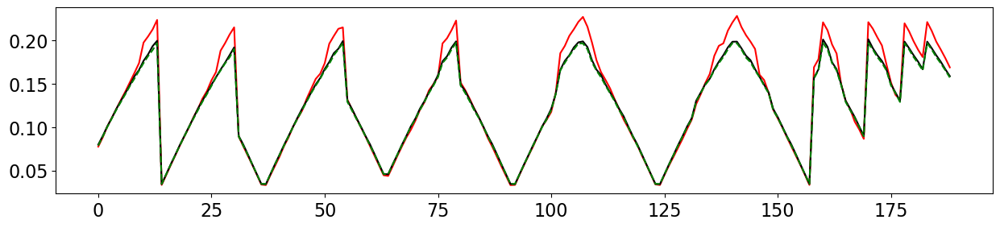

In [7]:
# Raytrace in initial model
initsurvey = survey_raytrace(survey, vel_init.T, x, z, lmax, nl, thetas, 
                             dzout=5., ray_rec_mindistance=5., debug=True)

# Match surveys
avasurvey_matched, initsurvey_matched = match_surveys(avasurvey, initsurvey, debug=True)

# Tomographic matrix and traveltimes
Rinit = tomographic_matrix(initsurvey_matched, dx, dz, 0, 0, nx, nz, x, z, 
                           plotflag=True, vel=vel_init, figsize=(15, 3))

tobs = extract_tobs(avasurvey_matched)
tobs_init = extract_tobs(initsurvey_matched)
tinit = Rinit @ (1/vel_init.ravel())

plt.figure(figsize=(15, 3))
plt.plot(tobs, 'r')
plt.plot(tobs_init, 'k')
plt.plot(tinit, '--g');

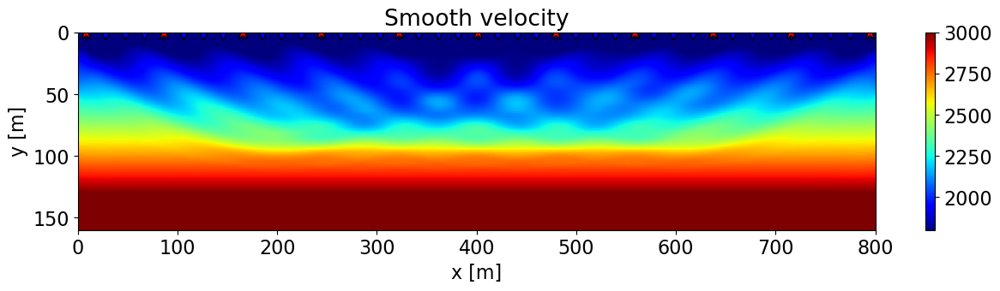

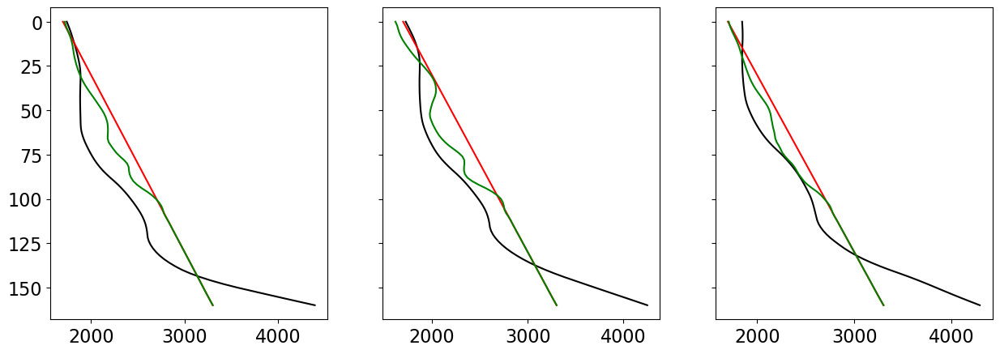

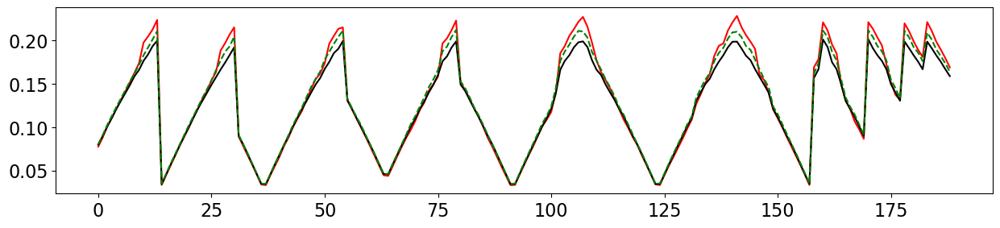

In [8]:
# Invert slowness model
Dop = Laplacian((nx, nz), weights=(10, 1))
slowninv = regularized_inversion(MatrixMult(Rinit), 
                                 tobs, [Dop,], epsRs=[2e2,], 
                                 x0=1./vel_init.ravel(), 
                                 **dict(iter_lim=100, damp=1e-1))[0]
vel_inv = 1. / (slowninv.reshape(nx, nz) + 1e-10)
tinv = Rinit @ (1/vel_inv.ravel())

plt.figure(figsize=(15, 3))
im = plt.imshow(vel_inv.T, cmap='jet', vmin=1800, vmax=3000, extent=(x[0], x[-1], z[-1], z[0]))
plt.scatter(recs[0], recs[1], marker='v', s=150, c='b', edgecolors='k')
plt.scatter(sources[0], sources[1], marker='*', s=150, c='r', edgecolors='k')
plt.colorbar(im)
plt.axis('tight')
plt.xlabel('x [m]'),plt.ylabel('y [m]')
plt.title('Smooth velocity')
plt.ylim(z[-1], z[0])

fig, axs = plt.subplots(1, 3, sharey=True, figsize=(15, 5))
for ax, ix in zip(axs, [nx//4, nx//2, 3*nx//4]):
    ax.plot(vel_sm[ix], z, 'k')
    ax.plot(vel_init[ix], z, 'r')
    ax.plot(vel_inv[ix], z, 'g')
axs[-1].invert_yaxis()
   
plt.figure(figsize=(15, 3))
plt.plot(tobs, 'r')
plt.plot(tobs_init, 'k')
plt.plot(tinv, '--g');

## Naive Gauss-Newton method

Iteration 1/10
survey_raytrace: 400 Source-receiver pairs in survey, 276 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 276 Rays in survey2, 189 Matched rays...
Iteration 2/10
survey_raytrace: 400 Source-receiver pairs in survey, 302 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 302 Rays in survey2, 218 Matched rays...
Iteration 3/10
survey_raytrace: 400 Source-receiver pairs in survey, 333 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 333 Rays in survey2, 248 Matched rays...
Iteration 4/10
survey_raytrace: 400 Source-receiver pairs in survey, 333 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 333 Rays in survey2, 255 Matched rays...
Iteration 5/10
survey_raytrace: 400 Source-receiver pairs in survey, 322 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 322 Rays in survey2, 249 Matched rays...
Iteration 6/10
survey_raytrace: 400 Source-receiver pairs in survey, 314 So

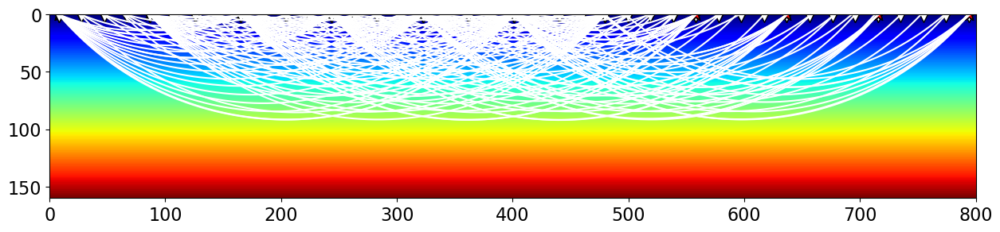

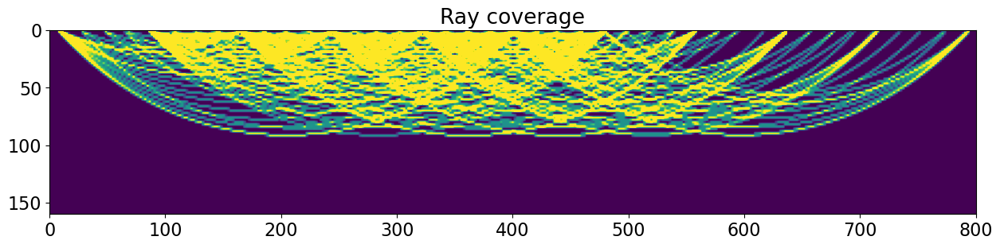

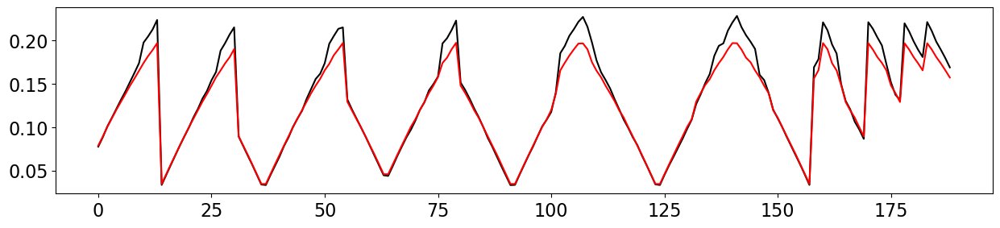

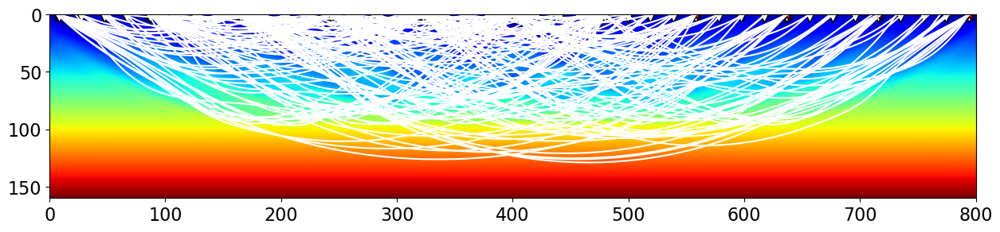

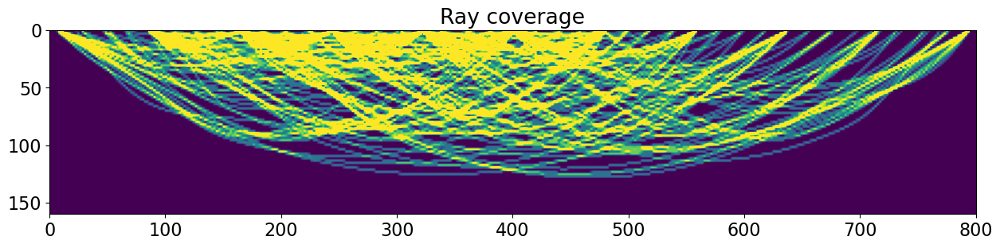

...

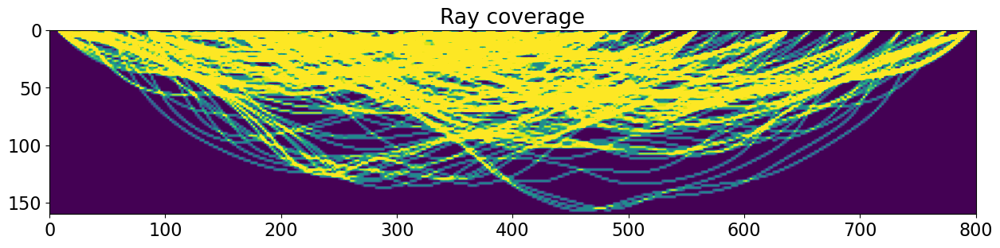

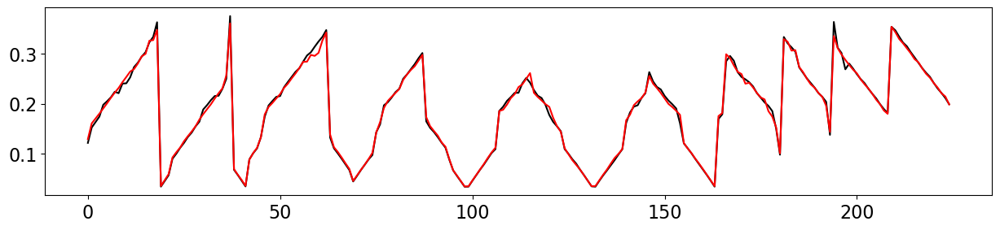

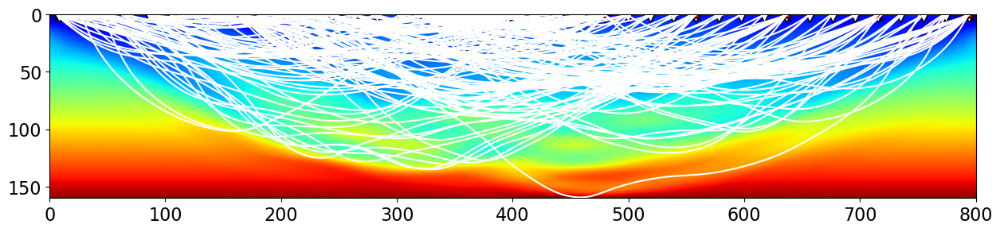

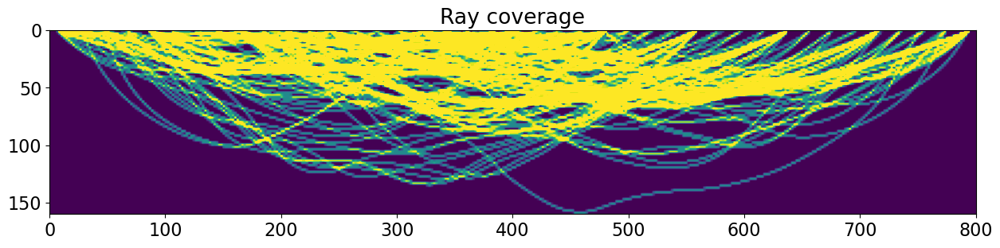

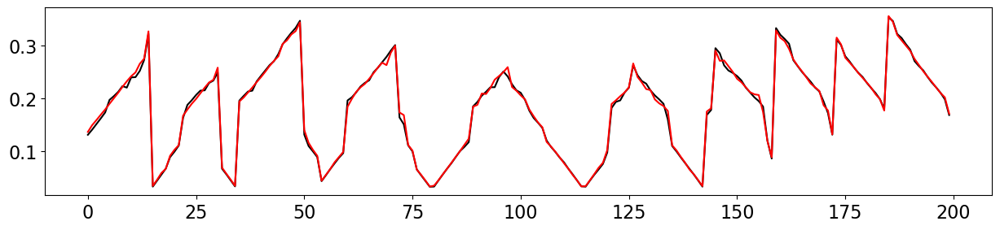

In [9]:
# first version, updating slow with full tobs at each step
ngniter = 10

Dop = Laplacian((nx, nz), weights=(10, 1))
vel_inv = vel_init.copy()
misfit = []
tin = time.time()
for iiter in range(ngniter):
    print(f'Iteration {iiter+1}/{ngniter}')
    # Raytrace in initial model
    invsurvey = survey_raytrace(survey, vel_inv.T, x, z, lmax, nl, thetas, 
                                dzout=5., ray_rec_mindistance=5., debug=True)

    # Match surveys
    avasurvey_matched, invsurvey_matched = match_surveys(avasurvey, invsurvey, debug=True)

    # Tomographic matrix and traveltimes
    Rinv = tomographic_matrix(invsurvey_matched, dx, dz, 0, 0, nx, nz, x, z, 
                              plotflag=True, vel=vel_inv, figsize=(15, 3))
    tobs = extract_tobs(avasurvey_matched)
    tinv = Rinv @ (1./vel_inv.ravel())
    plt.figure(figsize=(15, 3))
    plt.plot(tobs, 'k')
    plt.plot(tinv, 'r')
    misfit.append(np.linalg.norm(tobs - tinv) / len(tobs))
    
    # Invert slowness model (just few iterations to avoid overfitting at each step)
    slowninv = regularized_inversion(MatrixMult(Rinv), 
                                     tobs, [Dop,], epsRs=[8e1,], 
                                     x0=1./vel_inv.ravel(), 
                                     **dict(iter_lim=40, damp=1e-1))[0]
    vel_inv = 1. / (slowninv.reshape(nx, nz) + 1e-10)
tend = time.time()
print(f'Elapsed time: {tend-tin} sec')

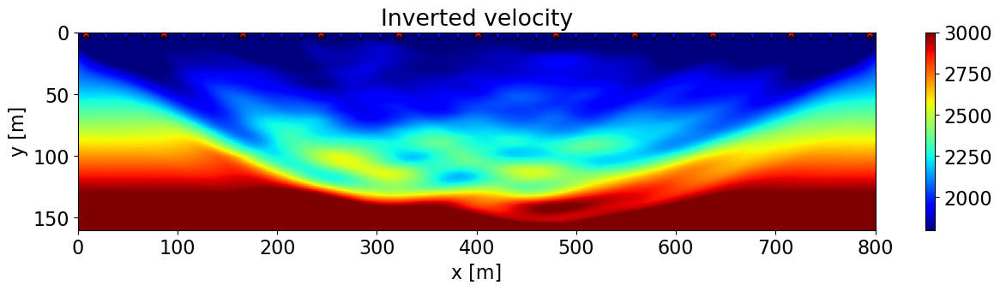

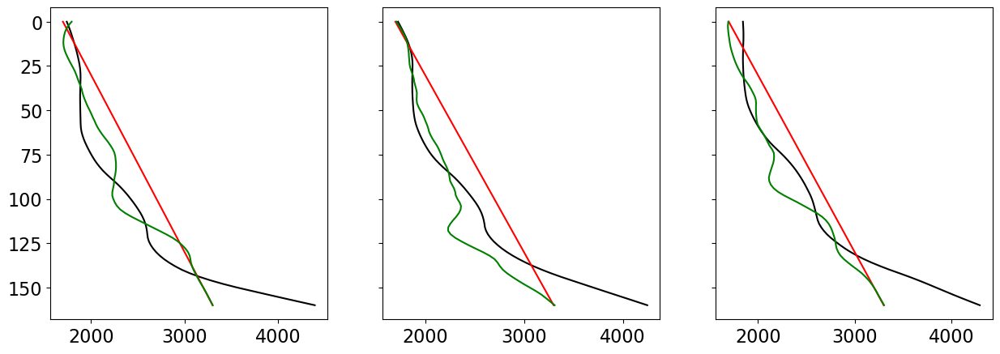

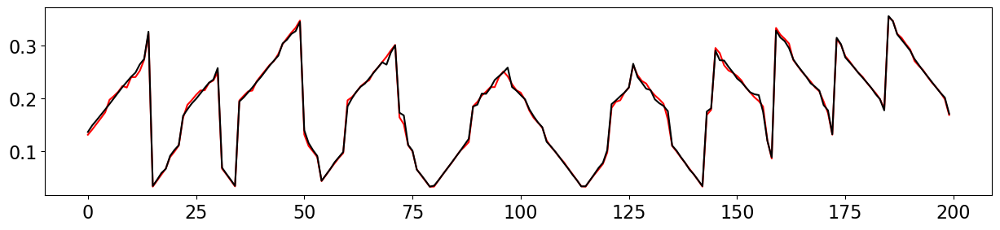

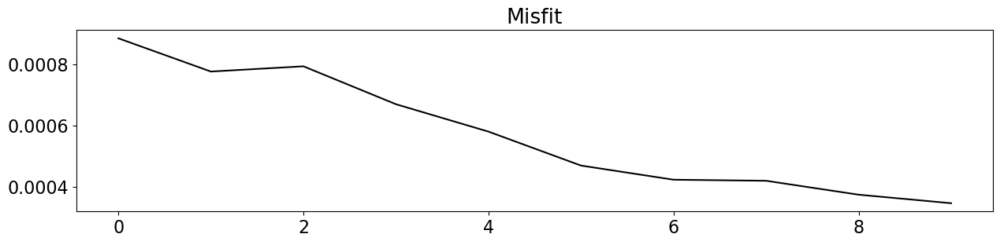

In [10]:
plt.figure(figsize=(15, 3))
im = plt.imshow(vel_inv.T, cmap='jet', vmin=1800, vmax=3000, extent=(x[0], x[-1], z[-1], z[0]))
plt.scatter(recs[0], recs[1], marker='v', s=150, c='b', edgecolors='k')
plt.scatter(sources[0], sources[1], marker='*', s=150, c='r', edgecolors='k')
plt.colorbar(im)
plt.axis('tight')
plt.xlabel('x [m]'),plt.ylabel('y [m]')
plt.title('Inverted velocity')
plt.ylim(z[-1], z[0])

fig, axs = plt.subplots(1, 3, sharey=True, figsize=(15, 5))
for ax, ix in zip(axs, [nx//4, nx//2, 3*nx//4]):
    ax.plot(vel_sm[ix], z, 'k')
    ax.plot(vel_init[ix], z, 'r')
    ax.plot(vel_inv[ix], z, 'g')
axs[-1].invert_yaxis()

tinv = Rinv @ (1/vel_inv.ravel())

plt.figure(figsize=(15, 3))
plt.plot(tobs, 'r')
plt.plot(tinv, 'k')

plt.figure(figsize=(15, 3))
plt.plot(misfit, 'k')
plt.title('Misfit');

Iteration 1/10
survey_raytrace: 400 Source-receiver pairs in survey, 276 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 276 Rays in survey2, 189 Matched rays...
tomographic_matrix: 189 rows, 32481 columns
RegularizedInversion
-----------------------------------------------------------------
The Operator Op has 189 rows and 32481 cols
Regs=[<32481x32481 Laplacian with dtype=float64>]
epsRs=[80.0]
-----------------------------------------------------------------
 
LSQR            Least-squares solution of  Ax = b
The matrix A has 32670 rows and 32481 columns
damp = 1.00000000000000e-01   calc_var =        0
atol = 1.00e-06                 conlim = 1.00e+08
btol = 1.00e-06               iter_lim =       40
 
   Itn      x[0]       r1norm     r2norm   Compatible    LS      Norm A   Cond A
     0  0.00000e+00   1.674e-01  1.674e-01    1.0e+00  2.4e+02
     1 -1.31118e-09   1.672e-01  1.672e-01    1.0e+00  1.3e-01   8.8e+02  1.0e+00
     2 -4.55183e-09   1.668e-01  1.

survey_raytrace: 400 Source-receiver pairs in survey, 333 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 333 Rays in survey2, 255 Matched rays...
tomographic_matrix: 255 rows, 32481 columns
RegularizedInversion
-----------------------------------------------------------------
The Operator Op has 255 rows and 32481 cols
Regs=[<32481x32481 Laplacian with dtype=float64>]
epsRs=[80.0]
-----------------------------------------------------------------
 
LSQR            Least-squares solution of  Ax = b
The matrix A has 32736 rows and 32481 columns
damp = 1.00000000000000e-01   calc_var =        0
atol = 1.00e-06                 conlim = 1.00e+08
btol = 1.00e-06               iter_lim =       40
 
   Itn      x[0]       r1norm     r2norm   Compatible    LS      Norm A   Cond A
     0  0.00000e+00   1.758e-01  1.758e-01    1.0e+00  1.1e+03
     1  1.58431e-08   1.753e-01  1.753e-01    1.0e+00  5.8e-02   2.5e+03  1.0e+00
     2  8.62711e-08   1.746e-01  1.746e-01    9.9e

survey_raytrace: 400 Source-receiver pairs in survey, 311 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 311 Rays in survey2, 240 Matched rays...
tomographic_matrix: 240 rows, 32481 columns
RegularizedInversion
-----------------------------------------------------------------
The Operator Op has 240 rows and 32481 cols
Regs=[<32481x32481 Laplacian with dtype=float64>]
epsRs=[80.0]
-----------------------------------------------------------------
 
LSQR            Least-squares solution of  Ax = b
The matrix A has 32721 rows and 32481 columns
damp = 1.00000000000000e-01   calc_var =        0
atol = 1.00e-06                 conlim = 1.00e+08
btol = 1.00e-06               iter_lim =       40
 
   Itn      x[0]       r1norm     r2norm   Compatible    LS      Norm A   Cond A
     0  0.00000e+00   9.855e-02  9.855e-02    1.0e+00  1.2e+03
     1  1.81469e-08   9.838e-02  9.838e-02    1.0e+00  5.5e-02   2.1e+03  1.0e+00
     2  4.52470e-08   9.815e-02  9.815e-02    1.0e

survey_raytrace: 400 Source-receiver pairs in survey, 311 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 311 Rays in survey2, 242 Matched rays...
tomographic_matrix: 242 rows, 32481 columns
RegularizedInversion
-----------------------------------------------------------------
The Operator Op has 242 rows and 32481 cols
Regs=[<32481x32481 Laplacian with dtype=float64>]
epsRs=[80.0]
-----------------------------------------------------------------
 
LSQR            Least-squares solution of  Ax = b
The matrix A has 32723 rows and 32481 columns
damp = 1.00000000000000e-01   calc_var =        0
atol = 1.00e-06                 conlim = 1.00e+08
btol = 1.00e-06               iter_lim =       40
 
   Itn      x[0]       r1norm     r2norm   Compatible    LS      Norm A   Cond A
     0  0.00000e+00   8.905e-02  8.905e-02    1.0e+00  1.2e+03
     1 -6.84171e-09   8.897e-02  8.897e-02    1.0e+00  3.3e-02   2.5e+03  1.0e+00
     2 -2.59561e-08   8.886e-02  8.886e-02    1.0e

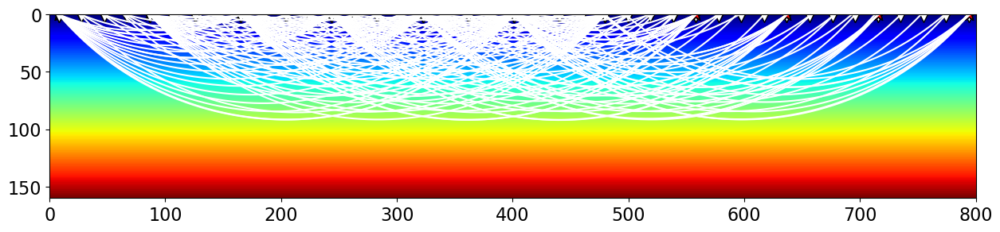

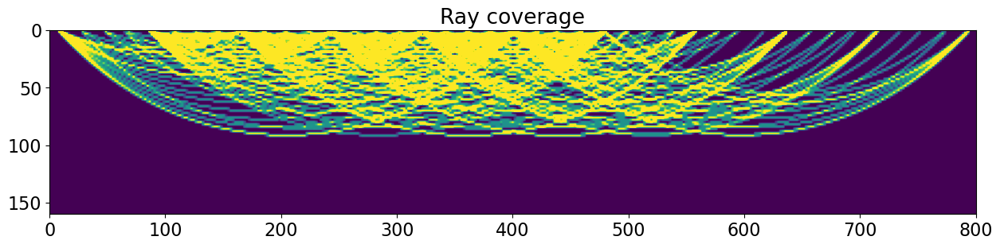

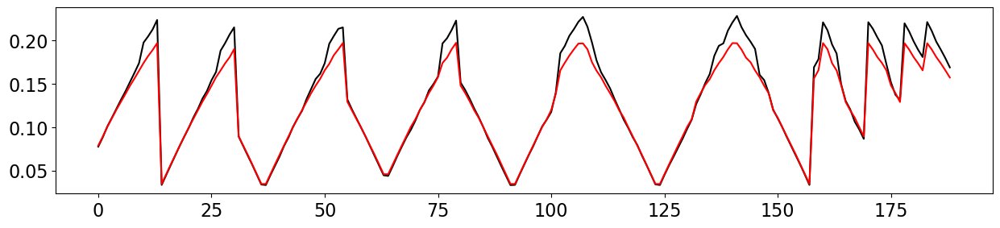

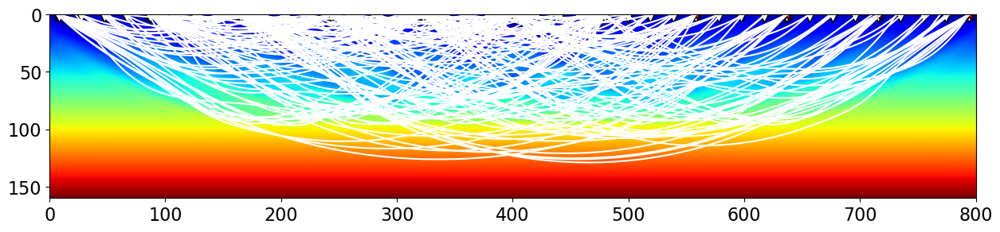

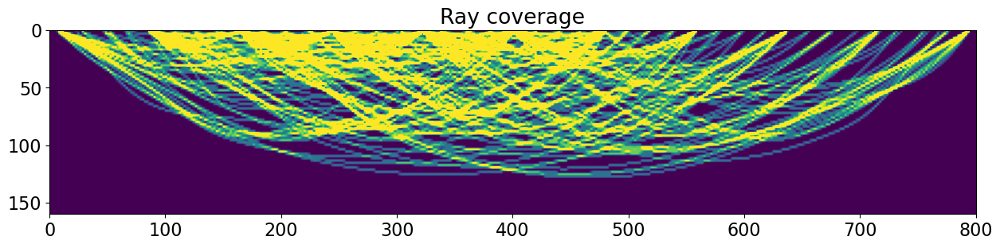

...

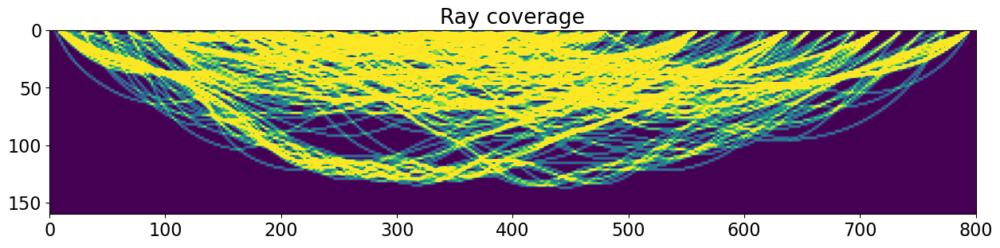

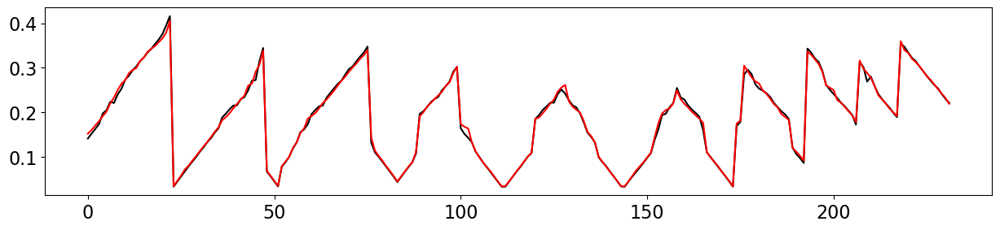

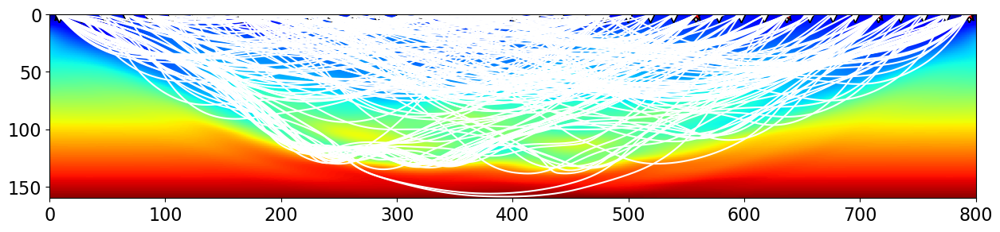

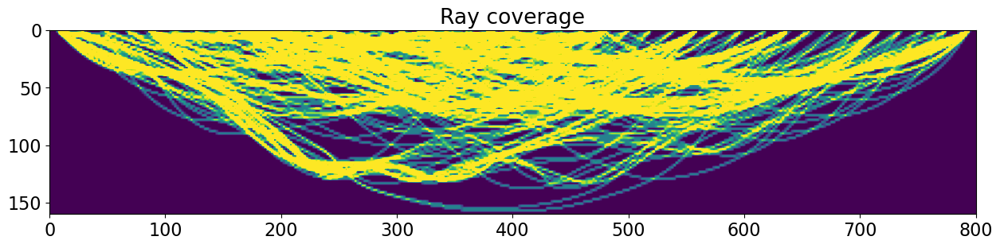

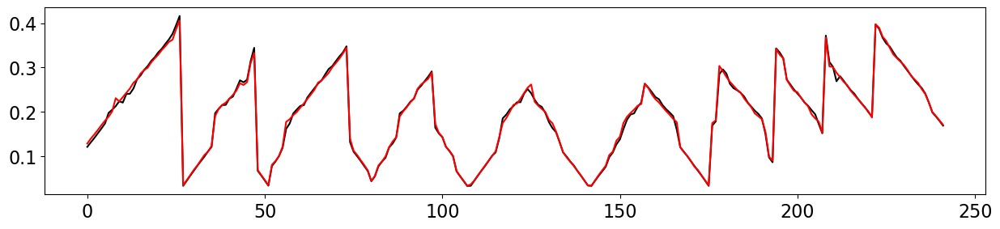

In [11]:
# second version, updating dslow with full dtobs at each step
ngniter = 10

Dop = Laplacian((nx, nz), weights=(10, 1))
vel_inv = vel_init.copy()
slown_inv = 1. / vel_inv.ravel()
misfit = []
tin = time.time()
for iiter in range(ngniter):
    print(f'Iteration {iiter+1}/{ngniter}')
    # Raytrace in initial model
    invsurvey = survey_raytrace(survey, vel_inv.T, x, z, lmax, nl, thetas, dzout=5., 
                                ray_rec_mindistance=5., debug=True)

    # Match surveys
    avasurvey_matched, invsurvey_matched = match_surveys(avasurvey, invsurvey, debug=True)

    # Tomographic matrix and traveltimes
    Rinv = tomographic_matrix(invsurvey_matched, dx, dz, 0, 0, nx, nz, x, z, 
                              plotflag=True, vel=vel_inv, debug=True)
    tobs = extract_tobs(avasurvey_matched)
    tinv = Rinv @ slown_inv
    
    # Residual data
    dtobs = tobs - tinv
    misfit.append(np.linalg.norm(dtobs) / len(tobs))
    plt.figure(figsize=(15, 3))
    plt.plot(tobs, 'k')
    plt.plot(tinv, 'r')
    
    # Invert slowness update (just few iterations to avoid overfitting at each step)
    dslown_inv = regularized_inversion(MatrixMult(Rinv), 
                                       dtobs, [Dop,], 
                                       epsRs=[8e1,], dataregs=[-Dop * slown_inv.ravel(), ], 
                                       **dict(iter_lim=40, damp=1e-1))[0]
    slown_inv += dslown_inv
    vel_inv = 1. / (slown_inv.reshape(nx, nz) + 1e-10)
tend = time.time()
print(f'Elapsed time: {tend-tin} sec')

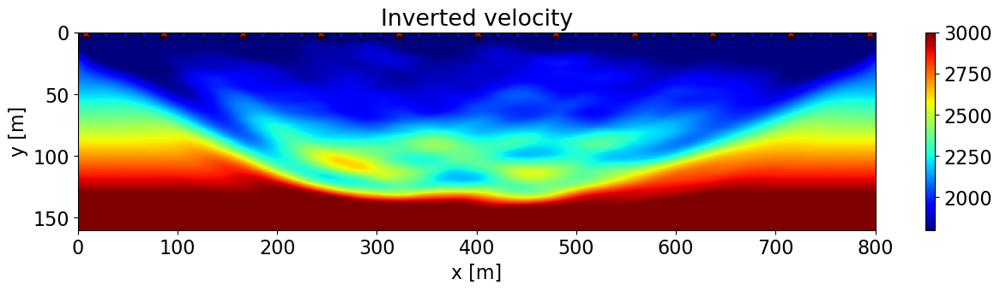

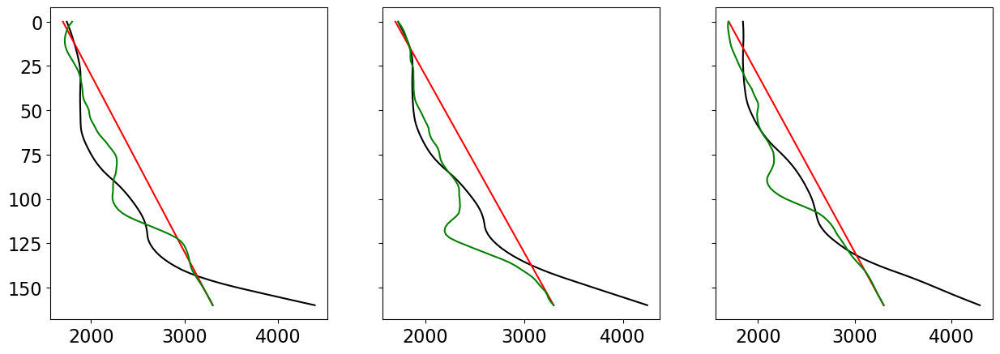

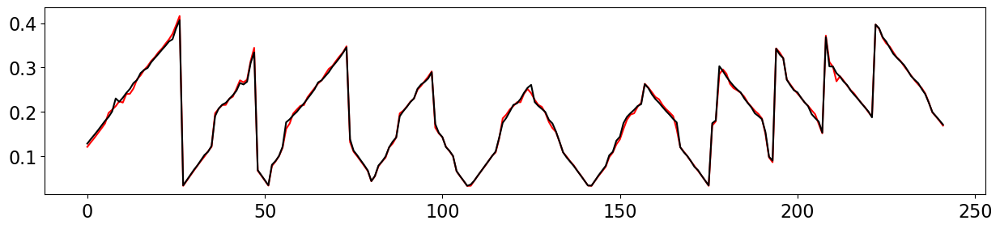

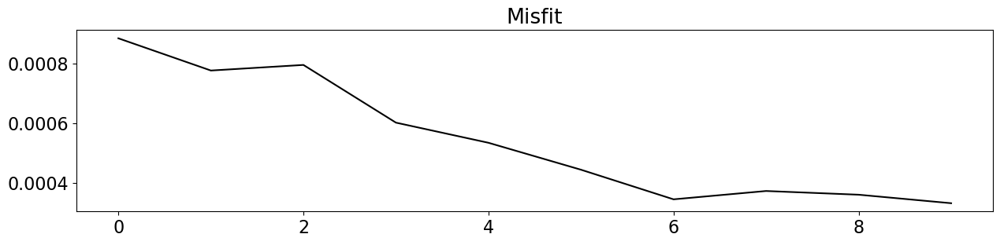

In [12]:
plt.figure(figsize=(15, 3))
im = plt.imshow(vel_inv.T, cmap='jet', vmin=1800, vmax=3000, extent=(x[0], x[-1], z[-1], z[0]))
plt.scatter(recs[0], recs[1], marker='v', s=150, c='b', edgecolors='k')
plt.scatter(sources[0], sources[1], marker='*', s=150, c='r', edgecolors='k')
plt.colorbar(im)
plt.axis('tight')
plt.xlabel('x [m]'),plt.ylabel('y [m]')
plt.title('Inverted velocity')
plt.ylim(z[-1], z[0])

fig, axs = plt.subplots(1, 3, sharey=True, figsize=(15, 5))
for ax, ix in zip(axs, [nx//4, nx//2, 3*nx//4]):
    ax.plot(vel_sm[ix], z, 'k')
    ax.plot(vel_init[ix], z, 'r')
    ax.plot(vel_inv[ix], z, 'g')
axs[-1].invert_yaxis()
  
tinv = Rinv @ (1/vel_inv.ravel())

plt.figure(figsize=(15, 3))
plt.plot(tobs, 'r')
plt.plot(tinv, 'k');

plt.figure(figsize=(15, 3))
plt.plot(misfit, 'k')
plt.title('Misfit');

## Proper Gauss-Newton method

Iteration 1/10
fun: Computing...
survey_raytrace: 400 Source-receiver pairs in survey, 276 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 276 Rays in survey2, 189 Matched rays...
tomographic_matrix: 189 rows, 32481 columns
fun: Elapsed time 24.866122007369995 s...
 
LSQR            Least-squares solution of  Ax = b
The matrix A has 32670 rows and 32481 columns
damp = 1.00000000000000e-01   calc_var =        0
atol = 1.00e-06                 conlim = 1.00e+08
btol = 1.00e-06               iter_lim =       40
 
   Itn      x[0]       r1norm     r2norm   Compatible    LS      Norm A   Cond A
     0  0.00000e+00   1.674e-01  1.674e-01    1.0e+00  2.4e+02
     1 -1.31118e-09   1.672e-01  1.672e-01    1.0e+00  1.3e-01   8.8e+02  1.0e+00
     2 -4.55183e-09   1.668e-01  1.668e-01    1.0e+00  4.4e-02   3.0e+03  6.4e+00
     3  3.69355e-09   1.663e-01  1.663e-01    9.9e-01  3.7e-02   3.9e+03  1.2e+01
     4 -4.00924e-08   1.656e-01  1.656e-01    9.9e-01  3.6e-02   4.7e+0

survey_raytrace: 400 Source-receiver pairs in survey, 327 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 327 Rays in survey2, 252 Matched rays...
tomographic_matrix: 252 rows, 32481 columns
fun: Elapsed time 44.30187106132507 s...
 
LSQR            Least-squares solution of  Ax = b
The matrix A has 32733 rows and 32481 columns
damp = 1.00000000000000e-01   calc_var =        0
atol = 1.00e-06                 conlim = 1.00e+08
btol = 1.00e-06               iter_lim =       40
 
   Itn      x[0]       r1norm     r2norm   Compatible    LS      Norm A   Cond A
     0  0.00000e+00   1.540e-01  1.540e-01    1.0e+00  8.9e+02
     1  3.20631e-08   1.537e-01  1.537e-01    1.0e+00  6.2e-02   2.1e+03  1.0e+00
     2  8.22579e-08   1.532e-01  1.532e-01    9.9e-01  4.3e-02   3.4e+03  3.2e+00
     3  1.06471e-07   1.527e-01  1.527e-01    9.9e-01  3.6e-02   4.2e+03  6.0e+00
     4  9.19779e-08   1.521e-01  1.521e-01    9.9e-01  3.1e-02   4.9e+03  9.1e+00
     5 -2.33045e-09   1

survey_raytrace: 400 Source-receiver pairs in survey, 309 Source-receiver paired with ray...
match_surveys: 305 Rays in survey1, 309 Rays in survey2, 243 Matched rays...
tomographic_matrix: 243 rows, 32481 columns
fun: Elapsed time 39.016170024871826 s...
 
LSQR            Least-squares solution of  Ax = b
The matrix A has 32724 rows and 32481 columns
damp = 1.00000000000000e-01   calc_var =        0
atol = 1.00e-06                 conlim = 1.00e+08
btol = 1.00e-06               iter_lim =       40
 
   Itn      x[0]       r1norm     r2norm   Compatible    LS      Norm A   Cond A
     0  0.00000e+00   9.751e-02  9.751e-02    1.0e+00  9.3e+02
     1  1.10697e-08   9.743e-02  9.743e-02    1.0e+00  3.9e-02   2.1e+03  1.0e+00
     2  2.50638e-08   9.730e-02  9.730e-02    1.0e+00  2.7e-02   3.4e+03  3.2e+00
     3  2.45686e-08   9.717e-02  9.717e-02    1.0e+00  2.2e-02   4.2e+03  5.8e+00
     4  1.00639e-08   9.703e-02  9.703e-02    1.0e+00  2.0e-02   4.9e+03  9.0e+00
     5 -3.42271e-08   

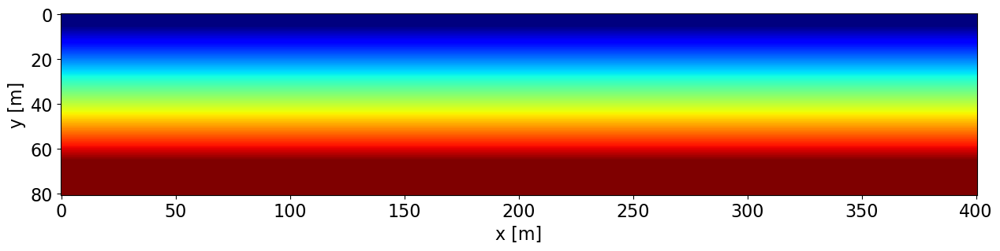

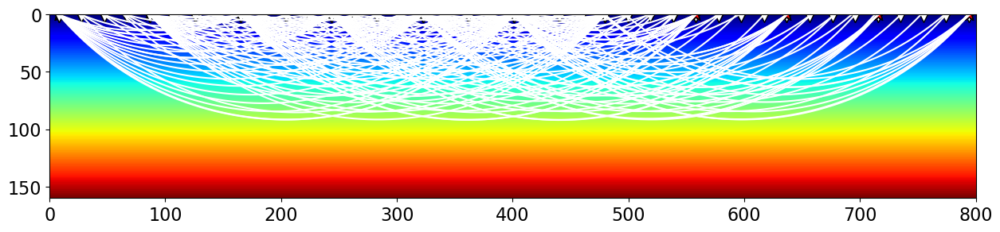

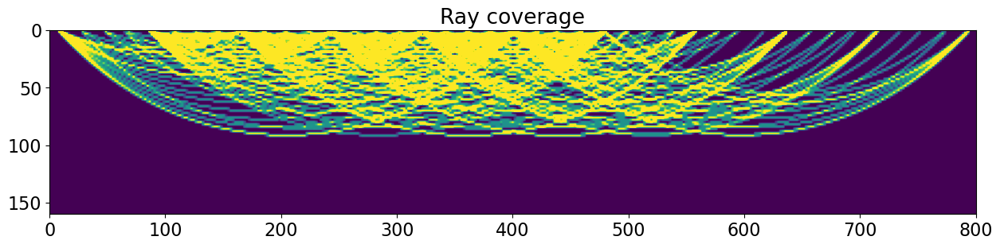

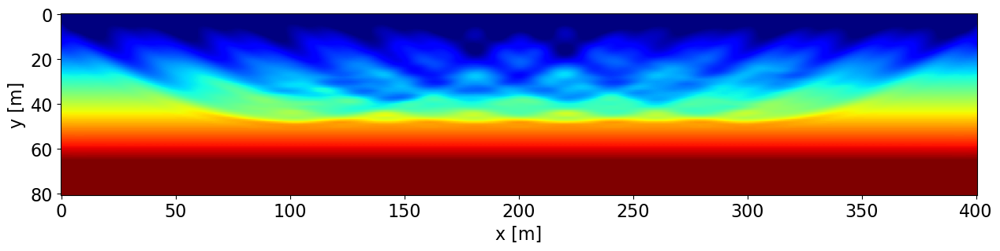

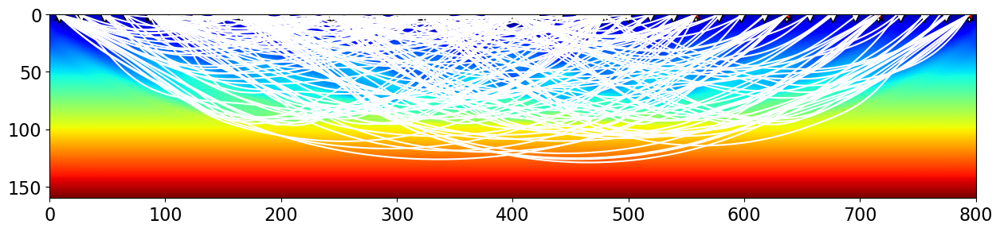

...

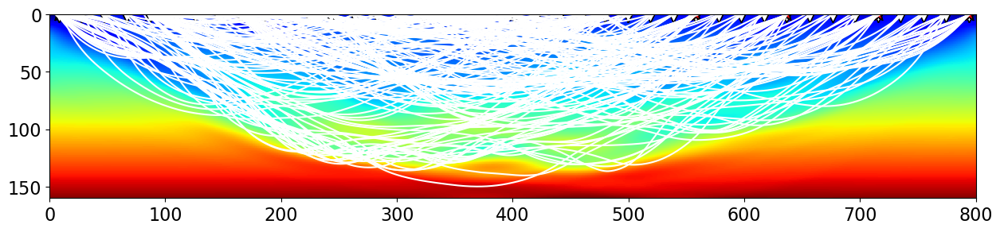

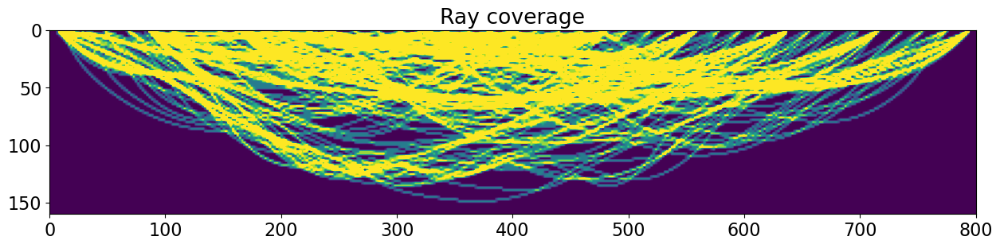

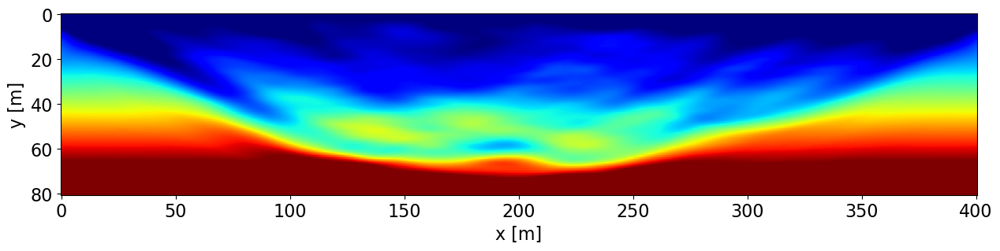

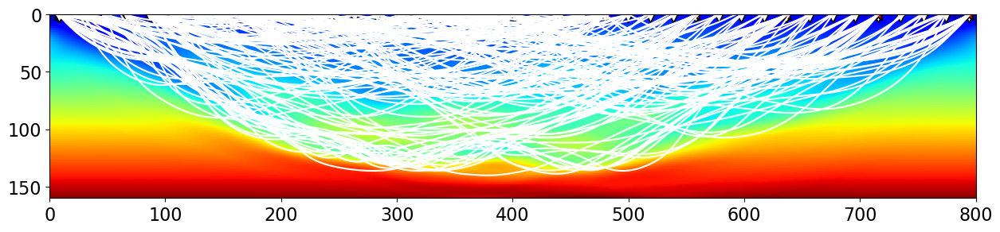

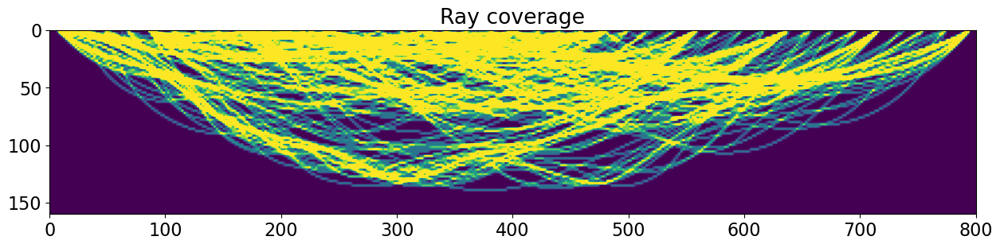

In [13]:
RTomo = RefrTomo(survey, avasurvey, x, z, lmax, nl, thetas, dzout=5., 
                 ray_rec_mindistance=5., epsL=8e1, weightsL=(10, 1), returnJ=True, 
                 debug=True)
vel_inv, misfit = RTomo.solve(vel_init, 10, lsqr_args=dict(iter_lim=40, damp=1e-1, show=True))

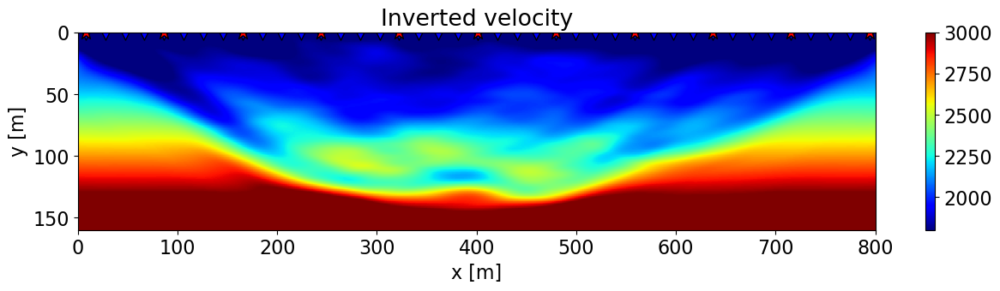

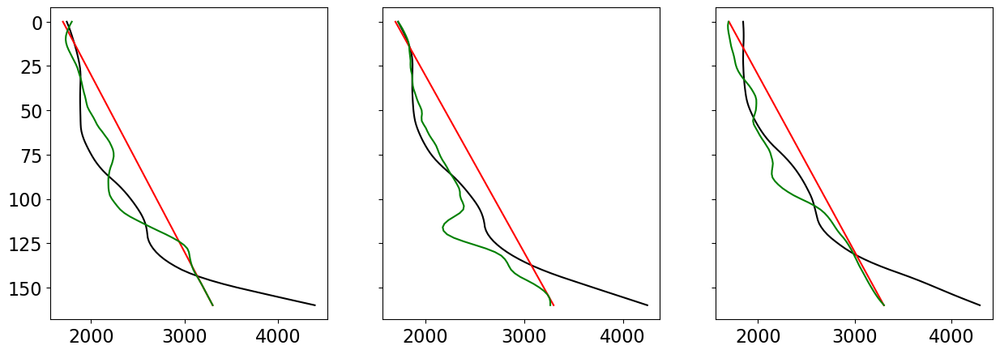

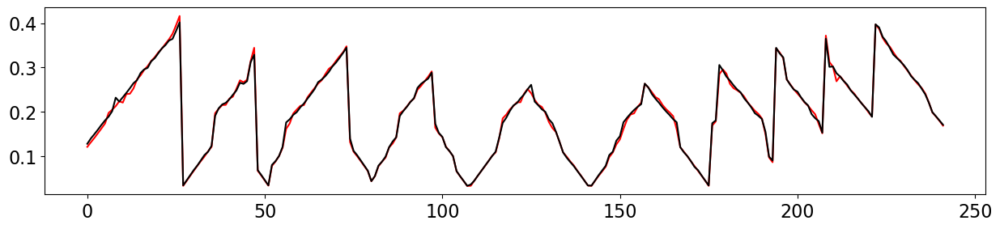

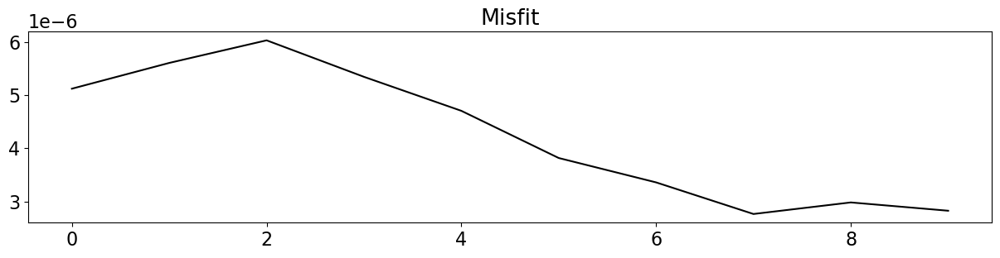

In [14]:
plt.figure(figsize=(15, 3))
im = plt.imshow(vel_inv.T, cmap='jet', vmin=1800, vmax=3000, extent=(x[0], x[-1], z[-1], z[0]))
plt.scatter(recs[0], recs[1], marker='v', s=150, c='b', edgecolors='k')
plt.scatter(sources[0], sources[1], marker='*', s=150, c='r', edgecolors='k')
plt.colorbar(im)
plt.axis('tight')
plt.xlabel('x [m]'),plt.ylabel('y [m]')
plt.title('Inverted velocity')
plt.ylim(z[-1], z[0])

fig, axs = plt.subplots(1, 3, sharey=True, figsize=(15, 5))
for ax, ix in zip(axs, [nx//4, nx//2, 3*nx//4]):
    ax.plot(vel_sm[ix], z, 'k')
    ax.plot(vel_init[ix], z, 'r')
    ax.plot(vel_inv[ix], z, 'g')
axs[-1].invert_yaxis()
  
tinv = Rinv @ (1/vel_inv.ravel())

plt.figure(figsize=(15, 3))
plt.plot(tobs, 'r')
plt.plot(tinv, 'k');

plt.figure(figsize=(15, 3))
plt.plot(misfit, 'k')
plt.title('Misfit');